# Рынок заведений общественного питания Москвы

# Тех. задание

Инвесторы из фонда «Shut Up and Take My Money» решили попробовать себя в новой области и открыть заведение общественного питания в Москве. Заказчики ещё не знают, что это будет за место: кафе, ресторан, пиццерия, паб или бар, — и какими будут расположение, меню и цены.

Необходимо подготовить исследование рынка Москвы, найти интересные особенности и презентовать полученные результаты, которые в будущем помогут в выборе подходящего инвесторам места.

# Описание данных

Путь файла: /datasets/moscow_places.csv


Границы районов Москвы, которые встречаются в датасете: admin_level_geomap.geojson
 * name — название заведения;
 * address — адрес заведения;
 * category — категория заведения, например «кафе», «пиццерия» или «кофейня»;
 * hours — информация о днях и часах работы;
 * lat — широта географической точки, в которой находится заведение;
 * lng — долгота географической точки, в которой находится заведение;
 * rating — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);
 * price — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;
 * avg_bill — строка, которая хранит среднюю стоимость заказа в виде диапазона, например:
  * «Средний счёт: 1000–1500 ₽»;
  * «Цена чашки капучино: 130–220 ₽»;
  * «Цена бокала пива: 400–600 ₽».и так далее;
  
  
 * middle_avg_bill — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»:
  * Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
  * Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
  * Если значения нет или оно не начинается с подстроки «Средний счёт», то в столбец ничего не войдёт.
  
  
 * middle_coffee_cup — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»:
  * Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
  * Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
  * Если значения нет или оно не начинается с подстроки «Цена одной чашки капучино», то в столбец ничего не войдёт.
  
  
 * chain — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки):
  * 0 — заведение не является сетевым
  * 1 — заведение является сетевым
  
  
 * district — административный район, в котором находится заведение, например Центральный административный округ;
 * seats — количество посадочных мест.

# Загрузка данных, изучение общей информации

In [1]:
#Импорт необходимых библиотек
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from plotly import graph_objects as go
from plotly.offline import iplot
from folium import Map, Marker
from folium.plugins import MarkerCluster
from folium import Map, Choropleth
from folium.features import CustomIcon
import plotly.express as px
import warnings

In [2]:
#Для снятия ограничений
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', -1) 
warnings.filterwarnings("ignore")

/tmp/ipykernel_238/515963861.py:3: FutureWarning:

Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.



In [3]:
#Сохраняем таблицу в датафрейм, и информацию о ней
patch = '/datasets/'
data = pd.read_csv(patch + 'moscow_places.csv')

In [4]:
display(data.head())
data.info()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


Выведем отдельно информацию о уникальных типах заведений, количестве, а так же с районом нахождения их для понимания качества данных (наличие дублей, стандарт регистра заполненной информации)

In [5]:
#Выведем уникальные типы заведений участвующих в выборке
print(f'Типы заведений:', data['category'].unique())

Типы заведений: ['кафе' 'ресторан' 'кофейня' 'пиццерия' 'бар,паб' 'быстрое питание'
 'булочная' 'столовая']


In [6]:
#Выведем количество уникальных заведений участвующих в выборке
print(f'Количество уникальных заведений:', data['name'].nunique(), 'из', data['name'].count())

Количество уникальных заведений: 5614 из 8406


In [7]:
#Выведем уникальные значения местоположения заведений
print(f'География заведений:', data['district'].unique())

География заведений: ['Северный административный округ'
 'Северо-Восточный административный округ'
 'Северо-Западный административный округ'
 'Западный административный округ' 'Центральный административный округ'
 'Восточный административный округ' 'Юго-Восточный административный округ'
 'Южный административный округ' 'Юго-Западный административный округ']


In [8]:
#Выведем долю пропусков по всему датасету
pd.DataFrame(round(data.isna().mean()*100,1)).style.background_gradient('coolwarm')

,0
name,0.000000
category,0.000000
address,0.000000
district,0.000000
hours,6.400000
lat,0.000000
lng,0.000000
rating,0.000000
price,60.600000
avg_bill,54.600000


<div style="border:solid green 2px; padding: 20px">
    В целом, ситуация с данными понятна. Путем вывода уникальных типов и местоположения заведений я отсеял допуск наличия в датасете неявных дублей которые могли бы помешать дальнейшей работе, вопрос к количеству уникальных заведений, ибо их 5614 из общего числа 8406. Возможно это связано с тем, что некоторые заведения относятся сразу к нескольким типам заведений (бред), возможно в данных есть одинаковые названия заведений не имеющие ничего общего между собой кроме самого названия (маловероятно, т.к. авторские права никто не отменял), а быть может это просто напросто дублируемая информация из-за ошибки в данных/человеческого фактора... Свет на правду прольет предобработка данных.  
    


Природа пропусков в столбцах с расчетом среднего чека тоже понятна. Все дело в механике заполнения данных, т.к. в зависимости от типа заведения заполняется тот или иной столбец с расчетом среднего значения чека. Это не является ошибкой, и данные пропуски следует оставить без изменений. С пропусками в категории цен и количестве посадочных мест дела обстоят иначе, т.к. датасет основан на метриках Яндекс Карт - он имеет исключительно информативный характер, и некоторые моменты могли попросту не заполняться. На данный момент тоже не считаю нужным с ними что-либо делать, но в дальнейшем возможно придется от них избавиться. Часы работы не заполнялись скорее всего по той же причине.

# Предобработка данных

Необходимо создать столбец отдельно с названием улиц, столбец с заведениями работающими 24/7

In [9]:
#Создадим столбец с названиями улиц, и столбец с круглосуточными заведениями
#Отделить название улицы кроме как сплитом мне больше ничего не приходит в голову...
data['street'] = data['address'].str.split(',').str[1]

#Добавим значение True заведениям которые работают круглосуточно, и вынсем в отдельный столбец
data['overtime'] = (data['hours'] == 'ежедневно, круглосуточно')

#Выведем эту красоту на экран, чтобы посмотреть что получилось
display(data.head())

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,overtime
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко,False
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица Дыбенко,False
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,Клязьминская улица,False
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица Маршала Федоренко,False
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,Правобережная улица,False


In [10]:
#Уберем дубли названий заведений
#data.drop_duplicates(subset=['name'], inplace=True)
#data.info()

<div style="border:solid green 2px; padding: 20px">
    Тут меня осенило на середине проекта, что эти дубли названий могут быть сетевыми заведениями! 😿 Я их оставлю

In [11]:
pd.DataFrame(round(data.isna().mean()*100,1)).style.background_gradient('coolwarm')

,0
name,0.000000
category,0.000000
address,0.000000
district,0.000000
hours,6.400000
lat,0.000000
lng,0.000000
rating,0.000000
price,60.600000
avg_bill,54.600000


<div style="border:solid green 2px; padding: 20px">
    Пропуски пока оставлю, в случае острой необходимости никогда не поздно с ними что-нибудь сделать :)

In [12]:
#Проверим датасет на явные и неявные дубиликаты
print('Количество дубликатов в датасете:', data.duplicated().sum())

Количество дубликатов в датасете: 0


# Анализ данных

Какие категории заведений представлены в данных? Исследовать количество объектов общественного питания по категориям: рестораны, кофейни, пиццерии, бары и так далее. Постройте визуализации. Ответить на вопрос о распределении заведений по категориям.

In [13]:
#Соберем сводную таблицу с количеством заведений в каждой категории.
category_count = data.pivot_table(values='name', index='category', aggfunc='count').sort_values(by='name', ascending=False).reset_index()
display(category_count)

,category,name
0,кафе,2378
1,ресторан,2043
2,кофейня,1413
3,"бар,паб",765
4,пиццерия,633
5,быстрое питание,603
6,столовая,315
7,булочная,256


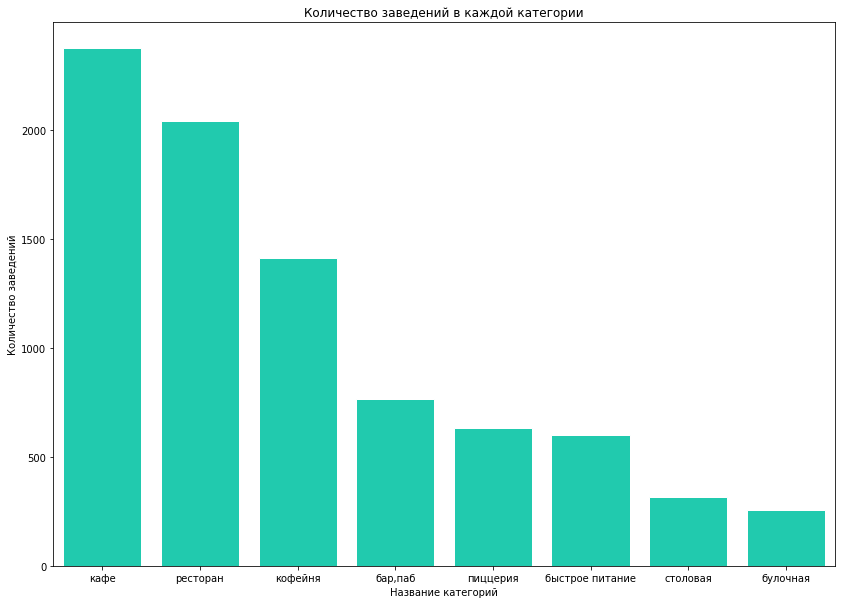

In [14]:
#Сопсна, выстроим визуализацию
plt.figure(figsize=(14, 10))
plt.title('Количество заведений в каждой категории')

sns.set(style="darkgrid")
sns.barplot(
    y='name', 
    x='category',
    data=category_count,
    color='#05e6c1')
plt.xlabel('Название категорий')
plt.ylabel('Количество заведений')

plt.show()

<div style="border:solid green 2px; padding: 20px">
    У нас представлены категории заведений: кафе, ресторан, кофейня, бар/паб, быстрое питание, пиццерия, столовая, булочная. Исходя из графика по количеству открытых заведений лидируют кафе и рестораны (кафе 1628 заведений, ресторанов 1444), на третьем месте по популярности кофейни - их 796. Так же наблюдается малое количество булочных, столовых, и пиццерий. Мое предположение, что фастфуд просто напросто забирает трафик этих категорий заведений в силу своей доступности и универсальности, отсюда и малое количество последних. 
    
Бары и пабы можно отнести к отдельной подкатегории, ибо специфика данных заведений отличается от остальных своей "философией", в этих заведениях делается ставка преимущественно на алкогольные напитки и соответствующую к ним кухню, тематика данных мест легко сосуществует с другими типами категорий общепита без какой-либо конкуренции.

Исследовать количество посадочных мест в местах по категориям: рестораны, кофейни, пиццерии, бары и так далее. Построить визуализации. Проанализировать результаты и сделайте выводы.

In [15]:
#Сделаем функцию, которая даст вывод о каждой отдельной категории по посадочным местам
#Группируем датафрейм по категориям
group_category = data.groupby('category')

#Выведем эту всю красоту
for i, x in group_category:
    print('Категория заведения: {}'.format(i))
    print(x['seats'].describe())
    print()

Категория заведения: бар,паб
count    468.000000 
mean     124.532051 
std      145.011574 
min      0.000000   
25%      48.000000  
50%      82.500000  
75%      150.000000 
max      1288.000000
Name: seats, dtype: float64

Категория заведения: булочная
count    148.000000
mean     89.385135 
std      97.685844 
min      0.000000  
25%      25.000000 
50%      50.000000 
75%      120.000000
max      625.000000
Name: seats, dtype: float64

Категория заведения: быстрое питание
count    349.000000 
mean     98.891117  
std      106.611739 
min      0.000000   
25%      28.000000  
50%      65.000000  
75%      140.000000 
max      1040.000000
Name: seats, dtype: float64

Категория заведения: кафе
count    1218.000000
mean     97.512315  
std      117.985084 
min      0.000000   
25%      35.250000  
50%      60.000000  
75%      120.000000 
max      1288.000000
Name: seats, dtype: float64

Категория заведения: кофейня
count    751.000000 
mean     111.199734 
std      127.837772 
min   

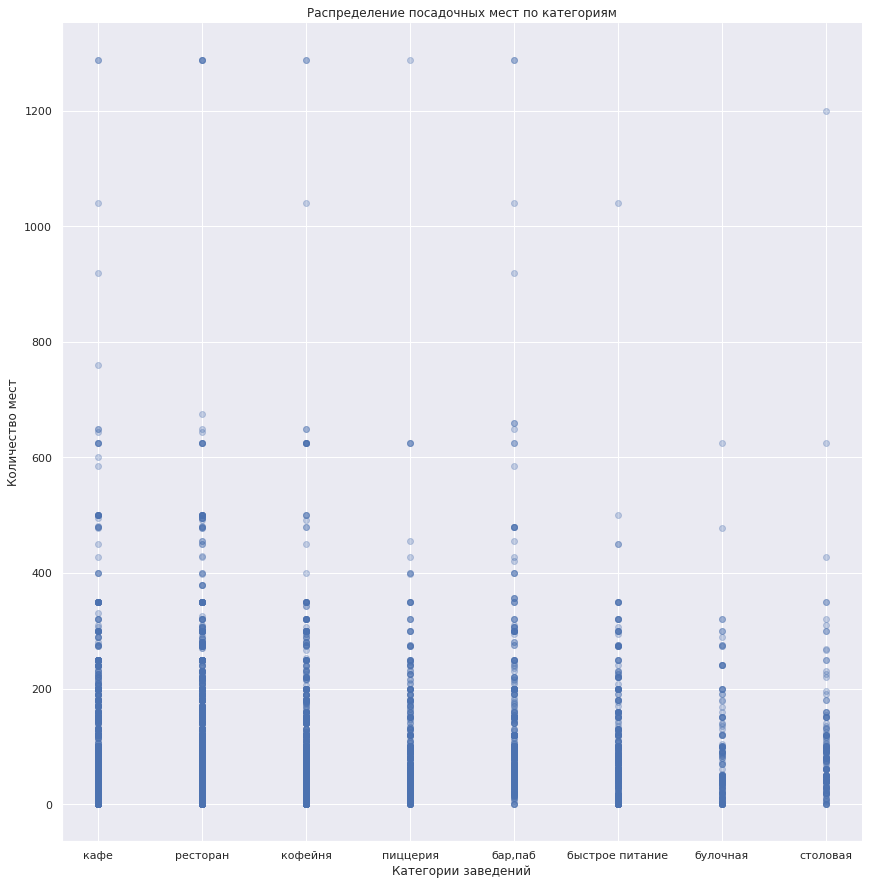

In [16]:
#Выстроим точечную диаграмму для наглядного понимания распределения количества мест по группам
#sns.set(style="darkgrid")
sns.lmplot(x='category',
           y='seats',
           palette='#05e6c1', #не хочет работать цвет, хоть убей :(
           scatter_kws={'alpha': 0.3},
           data=data,
           height=12,
           fit_reg=False)
#plt.xticks(rotation=(90))
plt.title('Распределение посадочных мест по категориям')
plt.xlabel('Категории заведений')
plt.ylabel('Количество мест')
plt.show() 

<div style="border:solid green 2px; padding: 20px">
Исходя из полученных данных, мы имеем полные сведния о количестве посадочных мест в каждой отдельной категории общепита. Наблюдаются аномальные значения почти в каждой из категорий, превышающие 1000 мест в заведениях разного типа. Так же можем наблюдать что это единичные случаи, а в большинстве своем количество посадочных мест не превышает 200, разве что некоторые кафе и рестораны имеют значения чуть выше.
    
Полагаю, что заведения со значением 0 по количеству мест работают по принципу дарксторов, только на вынос/доставку, например...

Возьмем среднее значение каждой категории, исходя из него построим график на котором будет видно все категории по убыванию среднего числа посадочных мест.

In [17]:
#Соберем датафрейм, в котором будут категории заведений, и среднее количество посадочных мест в них
category_seats_mean = round(data.pivot_table(values='seats', index='category', aggfunc='median')
                            .sort_values(by='seats', ascending=False)).reset_index()
display(category_seats_mean)

,category,seats
0,ресторан,86.0
1,"бар,паб",82.0
2,кофейня,80.0
3,столовая,76.0
4,быстрое питание,65.0
5,кафе,60.0
6,пиццерия,55.0
7,булочная,50.0


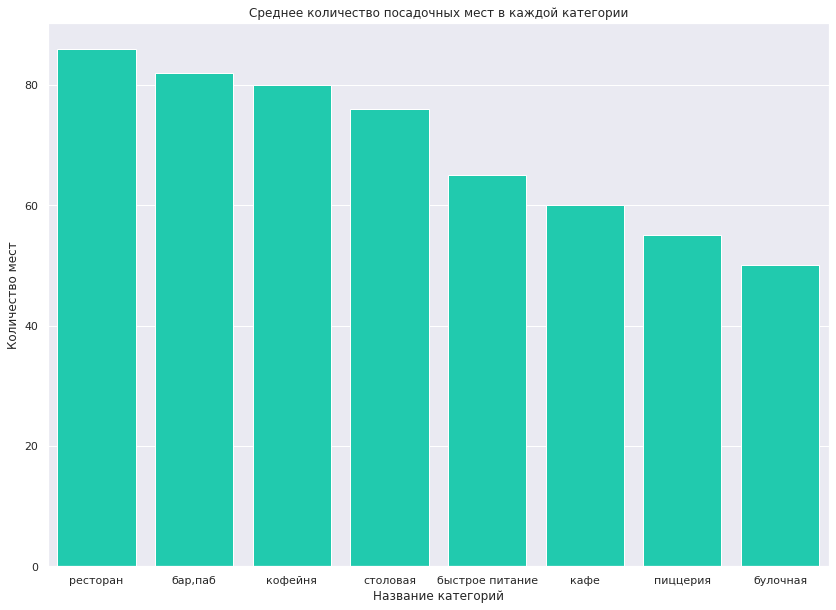

In [18]:
#Строим график
plt.figure(figsize=(14, 10))
plt.title('Среднее количество посадочных мест в каждой категории')

sns.set(style="darkgrid")
sns.barplot(
    y='seats', 
    x='category',
    data=category_seats_mean,
    color='#05e6c1')
plt.xlabel('Название категорий')
plt.ylabel('Количество мест')

plt.show()

<div style="border:solid green 2px; padding: 20px">
По среднему количеству посадочных мест лидируют такие позиции как бары/пабы, рестораны, и кофейни. Это объяснимо спецификой заведений и площадьми которые они занимают. Дело в том, что данные категории направлены на охват большого количества посетителей, потому с легкостью могут умещать большое количество людей. Формат столовых и быстрого питания как правило не имеют столь внушительных площадей нежели рестораны или кофейни, и предназначены на чуть более скромное количество посетителей, туда же можно отнести быстрое питание. Пиццерии и булочные как правило работают на вынос, потому им не требуется большое пространство для посадочных мест.

Рассмотрим и изобразим соотношение сетевых и несетевых заведений в датасете. Каких заведений больше?

In [19]:
#Соберем датафрейм, куда поместим сетевые и несетевые заведения.
name_chain = ['Не сеть', 'Сеть']
count_chain = data.pivot_table(index='chain', values='name', aggfunc='count').reset_index()
count_chain

,chain,name
0,0,5201
1,1,3205


In [20]:
#Построим график
fig = go.Figure(data=[go.Pie(labels=name_chain, values=count_chain['name'], title='Соотношение сетевых заведений к несетевым')])
fig.update_traces(hoverinfo='label+percent', textinfo='value', textfont_size=20)
fig.show()

<div style="border:solid green 2px; padding: 20px">
    Исходя из графика подавляющее большинство заведений не являются сетевыми. Сетевых 3205 заведения или 38.1% от общего числа, в то время как не сетевых насчитывается 5201, или 61.9%.

Какие категории заведений чаще являются сетевыми? Исследуем данные и построим график.

In [21]:
#Соберем датасет, в котором будут категории, общее количество заведений по категории, и идентификация по сеть/не сеть
chain_set = data.groupby(['category', 'chain'], \
                        as_index = False)[['name']].count().sort_values(by='name', ascending=False)

#Переименуем идентификаторы на более человеческий лад
chain_set.loc[chain_set['chain'] == 0, 'chain'] = 'Не сеть'
chain_set.loc[chain_set['chain'] == 1, 'chain'] = 'Сеть'

chain_set

,category,chain,name
6,кафе,Не сеть,1599
12,ресторан,Не сеть,1313
7,кафе,Сеть,779
13,ресторан,Сеть,730
9,кофейня,Сеть,720
8,кофейня,Не сеть,693
0,"бар,паб",Не сеть,596
4,быстрое питание,Не сеть,371
11,пиццерия,Сеть,330
10,пиццерия,Не сеть,303


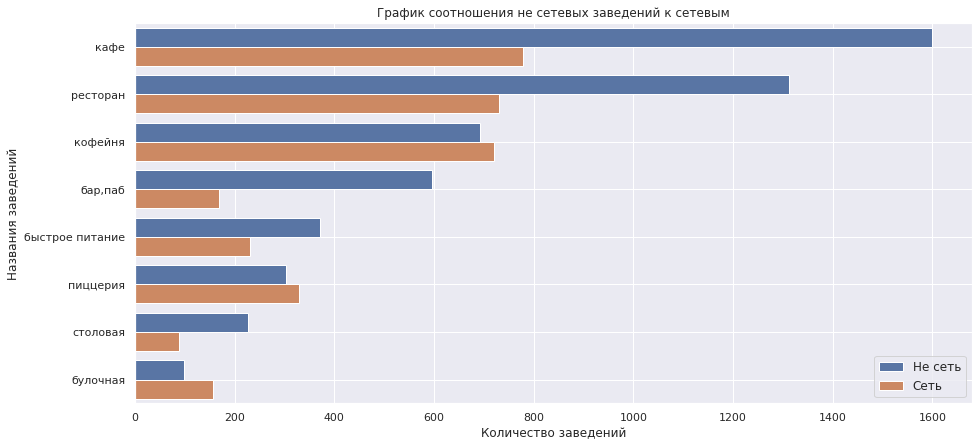

In [22]:
#Строим самый красивый на свете график
sns.set_style('dark')

plt.figure(figsize=(15, 7))
sns.barplot(x='name', y='category', data=chain_set, hue='chain')

plt.title('График соотношения не сетевых заведений к сетевым')
plt.xlabel('Количество заведений')
plt.ylabel('Названия заведений')

plt.xticks()
plt.legend(loc='lower right', fontsize=12)
plt.grid()
plt.show()

<div style="border:solid green 2px; padding: 20px">
График детально указывает соотношение не сетевых заведений к сетевым, с распределением по категориям. Таким образом мы видим что чаще всего сетевыми заведениями являются кафе, следом по значению идут рестораны, а потом кофейни. Примечательно то, что число сетевых заведений в категории кофейня превышает количество не сетевых. Пока не могу предположить с чем это может быть связано..

Сгруппируем данные по названиям заведений и найдите топ-15 популярных сетей в Москве. Под популярностью понимается количество заведений этой сети в регионе. Построим подходящую для такой информации визуализацию. 

In [23]:
#Соберем датасет, в котором сгруппируем данные по названиям заведений, и найдем топ 15 сетей по Мск
top_name = data.query('chain == 1').groupby(['name','category'],  as_index=False)['chain'].count().reset_index()
top_name = top_name.sort_values('chain', ascending=False).head(15)
top_name

,index,name,category,chain
1142,1142,Шоколадница,кофейня,119
504,504,Домино'с Пицца,пиццерия,76
497,497,Додо Пицца,пиццерия,74
206,206,One Price Coffee,кофейня,71
1158,1158,Яндекс Лавка,ресторан,69
73,73,Cofix,кофейня,65
242,242,Prime,ресторан,49
558,558,КОФЕПОРТ,кофейня,42
644,644,Кулинарная лавка братьев Караваевых,кафе,39
978,978,Теремок,ресторан,36


In [24]:
#Теперь построим график, показывающий популярность данных сетей
fig = px.bar(top_name, 
             x='name', 
             y='chain', 
             color='category', 
             title='График популярности сетей')

#my_colors = ['#800080', '#9932cc', '#8a2be2', '#ba55d3', '#ee82ee']
#fig.update_traces(marker_color=my_colors)
#fig.update_traces(marker_color='blue')
fig.show() 

<div style="border:solid green 2px; padding: 20px">
    Благодаря графику который указывает на популярность сетей с выделением их категорий, наблюдается наиболее популярная категория кофейня. В ней целых 6 сетевых заведений, с лидирующей позицией у "Шоколадницы", следом идут пиццерии Домино'с Пицца и Додо Пицца, две плотно конкурирующие сети имеющие очень близкий показатель по количеству точек (76 И 74), у категории ресторан лидирует Яндекс Лавка, потом неизвестный для меня Prime (информации в интернете так же не густо), и Теремок. Интересный момент что Яндекс Лавка работает как даркстор, а потому полагаю, указывается не количество заведений как таковых, а количество складов откуда собираются заказы.

Какие административные районы Москвы присутствуют в датасете? Отобразим общее количество заведений и количество заведений каждой категории по районам.

In [25]:
#Выведем все возможные районы из датасета
data['district'].unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

In [26]:
#Визуализируем информацию

#Координаты Москвы, широта и долгота
moscow_lat, moscow_lng = 55.751244, 37.618423

#Создаём карту Москвы
moscow_map_name = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

#Создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(moscow_map_name)

#Пишем функцию, которая принимает строку датафрейма,
#Создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['category']} {row['name']} {row['rating']}",
    ).add_to(marker_cluster)
    
#Применяем функцию create_clusters() к каждой строке датафрейма
data.apply(create_clusters, axis=1)

#Вывод
moscow_map_name

<div style="border:solid green 2px; padding: 20px">
Подумав что это именно то что от меня требуется, решил построить карту с заведениями, рейтингом, и категорией. Информация нужная, но бесполезная в данном вопросе :) Пускай будет, я старался

In [27]:
#Сделаем датафрейм с общим количеством заведений, категорий, и добавим районы
district_group = data.groupby(['category', 'district'], as_index=False)['name'].count().sort_values(by='name', ascending=False)
district_group.head()

,category,district,name
59,ресторан,Центральный административный округ,670
32,кафе,Центральный административный округ,464
41,кофейня,Центральный административный округ,428
5,"бар,паб",Центральный административный округ,364
33,кафе,Юго-Восточный административный округ,282


In [28]:
#Построим график с соотношением категорий по каждому району
fig = px.bar(district_group, x='district', y='name', color='category', text = 'name')
fig.update_layout(width=1000, height=800, title='Распределение категорий и количества заведений по районам')
fig.show()

<div style="border:solid green 2px; padding: 20px">
Данные на графике показывают нам количество заведений разных категорий в каждом отдельном районе. Таким образом, можно наблюдать картину того что центральный район перенасыщен ресторанами, кафе, кофейнями и барами. В центральном районе явно не стоит пытаться конкурировать с представителями данных сегментов общепита :) В остальных районах можно видеть примерно равномерную картину по распределению категорий заведений с преобладанием кафе в каждом из них. В северо-западном округе концентрация заведений ощутимо ниже чем где-либо еще, встает закономерный вопрос почему? Изучив карту,\ могу предположить что это связано с тем, что этот район не так густо заселен. Там наблюдаются научные/исследовательские центры, большой залив, много промышленных предприятий, полагаю что в данном районе жилой территории меньше чем в других. Мало населения->меньше спрос на заведения->низкая рентабельность заведений.

Визуализируем распределение средних рейтингов по категориям заведений.

In [29]:
#Датафрейм с категориями, районами, и средним рейтингом
mean_rating_district = data.pivot_table(index='district', columns='category', values='rating', aggfunc='mean')

#Отсортируем значения для более приятной глазу визуализации
mean_rating_sorted = mean_rating_district.sort_values(by=mean_rating_district.columns.tolist(), ascending=False)
mean_rating_sorted

category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая
district,,,,,,,,
Центральный административный округ,4.486264,4.372000,4.234483,4.302371,4.336449,4.411504,4.416119,4.315152
Западный административный округ,4.398000,4.264865,3.969355,4.075732,4.195333,4.288732,4.257339,4.112500
Северо-Западный административный округ,4.391304,4.283333,3.950000,4.047826,4.325806,4.337500,4.292661,4.188889
Юго-Западный административный округ,4.350000,4.155556,4.086885,4.036975,4.283333,4.340625,4.225595,4.241176
Северный административный округ,4.327941,4.253846,3.975862,4.180851,4.291710,4.292208,4.289947,4.217073
Восточный административный округ,4.315094,4.168000,4.043662,4.098162,4.282857,4.269444,4.186875,4.232500
Южный административный округ,4.276471,4.340000,4.101176,4.093939,4.232824,4.258904,4.212376,4.261364
Юго-Восточный административный округ,4.200000,4.038462,3.925373,4.047872,4.225843,4.185455,4.156552,4.104000
Северо-Восточный административный округ,4.190476,4.342857,4.032927,4.053532,4.216981,4.255882,4.209890,4.082500


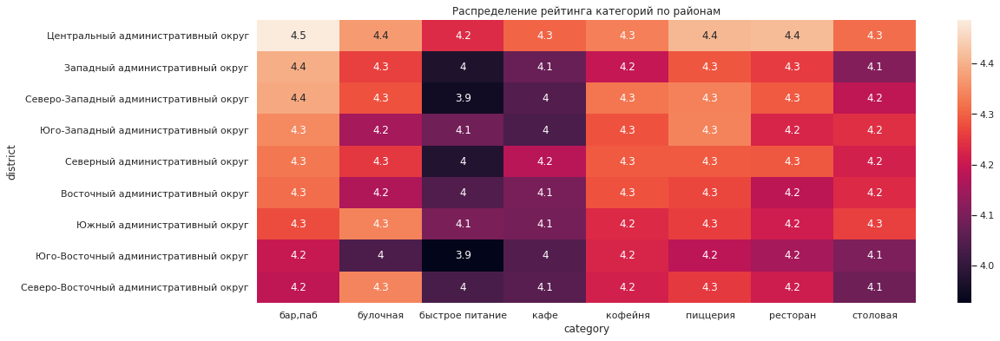

In [30]:
#Построим тепловую карту
plt.figure(figsize=(17,6))
plt.title('Распределение рейтинга категорий по районам')
sns.heatmap(mean_rating_sorted, annot=True)
plt.show()

<div style="border:solid green 2px; padding: 20px">
    На тепловой карте видно распределение категорий заведений по среднему рейтингу в зависимости от района. Преобладающей лояльностью у посетителей над остальными категориями обладают бары и пабы, обладая высшим показателем в 4.5 балла в центральном округе. Антагонистом рейтинга показывает себя категория быстрого питания. Только в этой категории встречаются оценки в 3.9 балла, являясь низшим показателем среди всех категорий. По остальным же можно сказать что показатель примерно равный, стабильные 4.2 - 4.3 балла в большинстве случаев. Так же можно добавить, что по всем категориям рейтинг центрального округа выше чем у других районов города. Полагаю это связано с повышенными требованиями к заведениям в данном районе и высокой конкуренцией. Центр имеет самый большой поток людей, а так же наибольшее количество заведений чем где-либо еще.
    
Можно сказать, что значения среднего рейтинга различаются зависимо от категории. Таким образом виден фаворит в глазах посетителей - бары и пабы, а так же понятно что быстрое питание имеет ряд моментов которые следует исправить для улучшения показателя рейтинга.

Построим фоновую картограмму со средним рейтингом заведений каждого района.

In [31]:
#отдельный средний рейтинг по районам
rating_district = data.groupby('district', as_index=False)['rating'].mean()
rating_district

,district,rating
0,Восточный административный округ,4.174185
1,Западный административный округ,4.181551
2,Северный административный округ,4.239778
3,Северо-Восточный административный округ,4.148260
4,Северо-Западный административный округ,4.208802
5,Центральный административный округ,4.377520
6,Юго-Восточный административный округ,4.101120
7,Юго-Западный административный округ,4.172920
8,Южный административный округ,4.184417


In [32]:
#Загружаем JSON-файл с границами округов Москвы
state_geo = '/datasets/admin_level_geomap.geojson'

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

#Создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# Создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=rating_district,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='PuBu',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)

#Вывод
m

<div style="border:solid green 2px; padding: 20px">
    Распределение среднего рейтинга на карте подтверждает данные тепловой карты. Центральный район имеет самый высокий рейтинг, юго-восточный и северо-восточный ниже всех. 

Отобразим все заведения датасета на карте с помощью кластеров средствами библиотеки folium.

In [33]:
#Как хорошо, что я это сделал раннее. Просто выведем карту с заведениями
moscow_map_name

Найдем топ-15 улиц по количеству заведений. Построим график распределения количества заведений и их категорий по этим улицам.

In [34]:
#Соберем датафрейм с улицами и количеством заведений.
street = data.pivot_table(index='street',values='name',aggfunc='count').sort_values(by='name', ascending=False).head(15)
#street

#Запихаем к нему категории для отображения на графике
top_street = data.query('street in @street.index').groupby(['street', 'category'], as_index=False).agg(count=('name', 'count')).sort_values('count', ascending=False)
top_street

,street,category,count
93,проспект Мира,кафе,53
63,МКАД,кафе,45
96,проспект Мира,ресторан,45
94,проспект Мира,кофейня,36
70,Профсоюзная улица,кафе,35
...,...,...,...
58,Люблинская улица,пиццерия,1
83,проспект Вернадского,булочная,1
23,Кутузовский проспект,булочная,1
66,МКАД,столовая,1


In [35]:
#Построим график распределения
fig = px.bar(top_street, x='street', y='count', color='category', barmode='group')
fig.update_layout(width=1000, height=600, title='Распределение категорий и количества заведений по районам',
                 xaxis_title='Название улицы',
                 yaxis_title='Количество заведений')
fig.show()

<div style="border:solid green 2px; padding: 20px">
    Кафе, рестораны и кофейни впереди всех по количеству заведений почти на каждой улице. На Проспекте Мира больше всего кафе и ресторанов с кофейнями, делаю вывод, что чем дальше от центра - тем менее насыщены улицы заведениями. Об этом говорят и предыдущие графики.

Найдем улицы, на которых находится только один объект общепита.

In [36]:
#Выведем на экран общее количество заведений
single = data.groupby('street').count().sort_values(by='name', ascending=True)
single = single[single['name'] == 1].index.to_list()
print('Всего одиночных заведений:', len(single))

#Отфильтруем улицы с единственным заведением
single_name = data.pivot_table(index='street',values='name',aggfunc='count').sort_values(by='name', ascending=False).query('name == 1')
single_name

#Отсортируем по категориям для построения графика
single_category = data.query('street in @single_name.index').groupby('category', as_index=False).agg(count=('name', 'count')).sort_values('count', ascending=False)
single_category

Всего одиночных заведений: 458


,category,count
3,кафе,160
6,ресторан,93
4,кофейня,84
0,"бар,паб",39
7,столовая,36
2,быстрое питание,23
5,пиццерия,15
1,булочная,8


In [37]:
fig = px.bar(single_category, x='category', y='count', color='category')
fig.update_layout(width=1000, height=600, title='Распределение категорий единичных заведений',
                 xaxis_title='Название категории',
                 yaxis_title='Количество заведений')
fig.show()

In [38]:
#Соберем датафрейм с фильтром только на одиночное заведение
data_single = data.query('street in @single')
data_single.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,overtime
15,Дом обеда,столовая,"Москва, улица Бусиновская Горка, 2",Северный административный округ,пн-пт 08:30–18:30; сб 10:00–20:00,55.885890,37.493264,4.1,средние,Средний счёт:300–500 ₽,400.0,NaN,0,180.0,улица Бусиновская Горка,False
21,7/12,кафе,"Москва, Прибрежный проезд, 7",Северный административный округ,"ежедневно, 10:00–22:00",55.876805,37.464934,4.5,NaN,NaN,NaN,NaN,0,NaN,Прибрежный проезд,False
25,В парке вкуснее,кофейня,"Москва, парк Левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,NaN,NaN,NaN,1,NaN,парк Левобережный,False
58,Coffeekaldi's,кофейня,"Москва, Угличская улица, 13, стр. 8",Северо-Восточный административный округ,"ежедневно, 09:00–22:00",55.900316,37.570558,4.1,средние,Средний счёт:500–800 ₽,650.0,NaN,1,NaN,Угличская улица,False
60,Чебуречная история,кофейня,"Москва, ландшафтный заказник Лианозовский",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.899845,37.570488,4.9,NaN,NaN,NaN,NaN,1,NaN,ландшафтный заказник Лианозовский,False


In [39]:
#Глянем на распределение по районам
single_district = data_single.groupby('district', as_index=False).agg(count=('name', 'count')).sort_values('count', ascending=False)

#Построим график
fig = px.bar(single_district, x='district', y='count', color='district')
fig.update_layout(width=1000, height=600, title='Распределение единичных заведений по районам',
                 xaxis_title='Название района',
                 yaxis_title='Количество заведений')
fig.show()

In [40]:
#Построим график с деталями распределения заведений по категориям и районам
fig = px.bar(data_single, x='district', y='name', color='category', barmode='group')
fig.update_layout(height=750, title='Распределение единичных заведений по районам с разделением на категории',
                 xaxis_title='Название района',
                 yaxis_title='Количество заведений')
fig.show()

<div style="border:solid green 2px; padding: 20px">
    Нам известно что количество заведений находящихся по одному на улице насчитывается 458. Так же выяснили что большинство этих заведений составляют кафе(160), рестораны(93), и кофейни(84). Большее число заведений находятся в центральном районе, это рестораны, бары и пабы, кофейни. Юго-запад наименее насыщен одиночными заведениями, относительно остальных районов

Посчитаем медиану среднего чека заведений для каждого района. Используем это значение в качестве ценового индикатора района. Построим фоновую картограмму с полученными значениями для каждого района. Проанализируем цены в центральном административном округе и других.

In [41]:
#Соберем датафрейм с разбивкой медианного значения среднего чека для каждого района
avg_district = data.groupby('district', as_index=False)['middle_avg_bill'].median().sort_values(by='middle_avg_bill', ascending=False)
display(avg_district)

#А это для меня
avg_district_cat = data.groupby(['district', 'category'], as_index=False)['middle_avg_bill'].median().sort_values(by='middle_avg_bill', ascending=False)
#avg_district_cat

,district,middle_avg_bill
1,Западный административный округ,1000.0
5,Центральный административный округ,1000.0
4,Северо-Западный административный округ,700.0
2,Северный административный округ,650.0
7,Юго-Западный административный округ,600.0
0,Восточный административный округ,575.0
3,Северо-Восточный административный округ,500.0
8,Южный административный округ,500.0
6,Юго-Восточный административный округ,450.0


In [42]:
#Построю график для собственного понимания ситуации
fig = px.bar(avg_district_cat, x='district', y='middle_avg_bill', color='category', barmode='group')
fig.update_layout(title='Распределение медианы среднего чека каждой категории по районам города',
                 xaxis_title='Название района',
                 yaxis_title='Медиана среднего чека')
fig.show()

In [43]:
#Строим хороплет
#Загружаем JSON-файл с границами округов Москвы
state_geo = '/datasets/admin_level_geomap.geojson'

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

#Создаём карту Москвы
map_avg_district = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

#Создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=avg_district,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='Oranges',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(map_avg_district)

#Вывод
map_avg_district

<div style="border:solid green 2px; padding: 20px">
На карте видно что центральный и юго-западный районы имеют самый высокий средний чек, южный, юго-восточный и северо-востоный напротив, имеют наименьший чек в рейтинге районов города. Думаю здесь есть прямая корелляция с потоком клиентов/туристов, и стоимостью недвижимости в этих районах.

<div style="border:solid green 2px; padding: 20px">
<h1>Вывод</h1>
    
Исходя из проведенного анализа данных, мы имеем следующие факты:
    
    * У нас представлены категории заведений: кафе, ресторан, кофейня, бар/паб, быстрое питание, пиццерия, столовая, булочная. Исходя из графика по количеству открытых заведений лидируют кафе и рестораны (кафе 1628 заведений, ресторанов 1444), на третьем месте по популярности кофейни - их 796.
    
    * Мы имеем полные сведния о количестве посадочных мест в каждой отдельной категории общепита. По среднему показателю лидируют бары и пабы - 125 посадочных мест, рестораны 122, и у кофейн 111 мест.
    
    * Подавляющее большинство заведений не являются сетевыми. Сетевых 3205 заведения или 38.1% от общего числа, в то время как не сетевых насчитывается 5201, или 61.9%.
    
    * Чаще всего сетевыми заведениями являются кафе, следом по значению идут рестораны, а потом кофейни. Примечательно то, что число сетевых заведений в категории кофейня превышает количество не сетевых.
    
    * Благодаря графику который указывает на популярность сетей с выделением их категорий, наблюдается наиболее популярная категория кофейня. В ней целых 6 сетевых заведений, что говорит о наивысшей конкуренции.
    
    * Центральный район перенасыщен ресторанами, кафе, кофейнями и барами. В остальных районах можно видеть примерно равномерную картину по распределению категорий заведений с преобладанием кафе в каждом из них. В северо-западном округе концентрация заведений ощутимо ниже чем где-либо еще.
    
    * Преобладающей лояльностью у посетителей над остальными категориями обладают бары и пабы, обладая высшим показателем в 4.5 балла в центральном округе. Антагонистом рейтинга показывает себя категория быстрого питания имея низшее значение в 3.9 балла. Центральный район имеет самый высокий рейтинг, юго-восточный и северо-восточный ниже всех.
    
    * Кафе, рестораны и кофейни впереди всех по количеству заведений почти на каждой улице. На Проспекте Мира больше всего кафе и ресторанов с кофейнями, делаю вывод, что чем дальше от центра - тем менее насыщены улицы заведениями.
    
    * Нам известно что количество заведений находящихся по одному на улице насчитывается 458. Большинство из них составляют кафе(160), рестораны(93), и кофейни(84). Большее число заведений находятся в центральном районе, это рестораны, бары и пабы, кофейни. Юго-запад наименее насыщен одиночными заведениями, относительно остальных районов.
    
    * Центральный и юго-западный районы имеют самый высокий средний чек пробивающий отметку в 1200 рублей, южный, юго-восточный и северо-востоный напротив, имеют наименьший чек стоимостью до 1000 рублей в рейтинге районов города. Исключением является категория баров и пабов в южном округе, там средний чек выше тысячи.

# Детализация исследования: открытие кофейни

Ответим на следующие вопросы:
* Сколько всего кофеен в датасете? В каких районах их больше всего, каковы особенности их расположения?
* Есть ли круглосуточные кофейни?
* Какие у кофеен рейтинги? Как они распределяются по районам?
* На какую стоимость чашки капучино стоит ориентироваться при открытии и почему?

In [44]:
#Соберем датафрейм где отфильтруем категорию заведения только по кофейням
data_coffee = data.query('category == "кофейня"')
display(data_coffee.head())
print( 'Общее количество кофеен по городу:', (data_coffee['name'].count()))

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,overtime
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица Маршала Федоренко,False
25,В парке вкуснее,кофейня,"Москва, парк Левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,NaN,NaN,NaN,1,NaN,парк Левобережный,False
45,9 Bar Coffee,кофейня,"Москва, Коровинское шоссе, 41, стр. 1",Северный административный округ,пн-пт 08:00–18:00,55.885837,37.513422,4.0,NaN,NaN,NaN,NaN,1,46.0,Коровинское шоссе,False
46,CofeFest,кофейня,"Москва, улица Маршала Федоренко, 6с1",Северный административный округ,пн-пт 09:00–19:00,55.879934,37.492522,3.6,NaN,NaN,NaN,NaN,1,NaN,улица Маршала Федоренко,False
52,Cofix,кофейня,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 08:00–22:00",55.878531,37.479395,3.8,NaN,NaN,NaN,NaN,1,NaN,улица Дыбенко,False


Общее количество кофеен по городу: 1413


In [45]:
#Сводная таблица для построения графика
barp_coffee = data_coffee.groupby('district', as_index=False)['name'].count().sort_values(by='name', ascending=False)

#Сначала визуализируем распределение привычной столбчатой диаграмой
fig = px.bar(barp_coffee, x='district', y='name', color='district', text = 'name')
fig.update_layout(title='Распределение кофеен по районам',
                 xaxis_title='Название района',
                 yaxis_title='Количество кофеен')
fig.show()

In [46]:
#Построим хороплет по районам
#Загружаем JSON-файл с границами округов Москвы
state_geo = '/datasets/admin_level_geomap.geojson'

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

#Создаём карту Москвы
map_coffee_district = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

#Создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=barp_coffee,
    columns=['district', 'name'],
    key_on='feature.name',
    fill_color='YlOrRd',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(map_coffee_district)

#Вывод
map_coffee_district

<div style="border:solid green 2px; padding: 20px">
    Таким образом мы выяснили что самая большая концентрация кофеен (428 точек) расположена в центре города. В данном районе не стоит открывать заведение на начальном этапе в силу высочайшей конкуренции и плотности расположения точек конкурентов. Самые оптимальные районы на мой взгляд - восточный (105 точек) и юго-восточный(89 точек). Малое количество распределения кофеен, низкая конкуренция, золотая середина распределения среднего чека из всех районов, при этом все усеяно спальными районами и внушительными парками, а это положительно влияет на плотность охвата аудитории клиентов.

In [47]:
#Соберем датафрейм с фильтром на круглосуточные точки
overtime_coffee = data_coffee.query('overtime == 1')
display(overtime_coffee.head())
print('Количество круглосуточных кофеен:', overtime_coffee['overtime'].count())

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,overtime
200,Wild Bean,кофейня,"Москва, Дмитровское шоссе, 107Е",Северный административный округ,"ежедневно, круглосуточно",55.878477,37.543426,3.5,NaN,NaN,NaN,NaN,1,20.0,Дмитровское шоссе,True
971,Wild Bean Cafe,кофейня,"Москва, Ярославское шоссе, 116",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.867822,37.708853,4.0,NaN,NaN,NaN,NaN,1,25.0,Ярославское шоссе,True
1047,Wild Bean Cafe,кофейня,"Москва, Ярославское шоссе, вл3с3",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.851778,37.676423,4.5,NaN,Цена чашки капучино:140–200 ₽,NaN,170.0,1,NaN,Ярославское шоссе,True
1214,Wild Bean Cafe,кофейня,"Москва, МКАД, 65-й километр, 8",Северо-Западный административный округ,"ежедневно, круглосуточно",55.813787,37.390701,4.3,NaN,NaN,NaN,NaN,1,NaN,МКАД,True
1291,Шоколадница,кофейня,"Москва, улица Народного Ополчения, 49, корп. 1",Северо-Западный административный округ,"ежедневно, круглосуточно",55.794815,37.494834,4.2,средние,Средний счёт:650–850 ₽,750.0,NaN,1,200.0,улица Народного Ополчения,True


Количество круглосуточных кофеен: 59


In [48]:
#Для построения графиков
overtime_barp = overtime_coffee.groupby('district', as_index=False)['name'].count().sort_values(by='name', ascending=False)

In [49]:
#Построим распределение по районам
fig = px.bar(overtime_barp, x='district', y='name', color='district', text = 'name')
fig.update_layout(title='Распределение круглосуточных кофеен по районам',
                 xaxis_title='Название района',
                 yaxis_title='Количество кофеен')
fig.show()

<div style="border:solid green 2px; padding: 20px">
В целом, круглосуточных кофеен не много, всего 59 точек на весь город, 26 из которых находятся в центральном районе.

In [50]:
#найдем ерйтинги кофеен, и посмотрим на распределение по городу
rating_coffee_district = data_coffee.groupby('district', as_index=False)['rating'].mean().sort_values(by='rating', ascending=False)
rating_coffee_district

,district,rating
5,Центральный административный округ,4.336449
4,Северо-Западный административный округ,4.325806
2,Северный административный округ,4.291710
7,Юго-Западный административный округ,4.283333
0,Восточный административный округ,4.282857
8,Южный административный округ,4.232824
6,Юго-Восточный административный округ,4.225843
3,Северо-Восточный административный округ,4.216981
1,Западный административный округ,4.195333


In [51]:
fig = px.bar(rating_coffee_district, x='district', y='rating', text = 'rating')
fig.update_layout(title='Распределение среднего рейтинга кофеен по районам',
                 xaxis_title='Название района',
                 yaxis_title='Рейтинг')
fig.show()

<div style="border:solid green 2px; padding: 20px">
    Столбчатый график не информативен, так что лучше построить распределение на карте

In [52]:
#Построим хороплет по рейтингу
#Загружаем JSON-файл с границами округов Москвы
state_geo = '/datasets/admin_level_geomap.geojson'

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

#Создаём карту Москвы
map_rating = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

#Создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=rating_coffee_district,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='PuBuGn',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(map_rating)

#Вывод
map_rating

<div style="border:solid green 2px; padding: 20px">
Самый высокий рейтинг наблюдается в центре и северо-западном районе. Самые благоприятные районы для открытия точки южный, и юго-восточный, рейтинг заведений там не высок, а значит путем зарабатывания высокого рейтинга можно закрепиться среди не высокой конкуренции.

In [53]:
#Соберем сводную таблицу со средним значением чашки кофе по районам
avg_total_coffee = data_coffee.groupby('district', as_index=False)['middle_coffee_cup'].mean().sort_values(by='middle_coffee_cup', ascending=False)
avg_total_coffee

,district,middle_coffee_cup
1,Западный административный округ,189.938776
5,Центральный административный округ,187.518519
7,Юго-Западный административный округ,184.176471
0,Восточный административный округ,174.023810
2,Северный административный округ,165.789474
4,Северо-Западный административный округ,165.523810
3,Северо-Восточный административный округ,165.333333
8,Южный административный округ,158.488372
6,Юго-Восточный административный округ,151.088235


In [54]:
#Построим распределение по районам
fig = px.bar(avg_total_coffee, x='district', y='middle_coffee_cup', color='district', text = 'middle_coffee_cup')
fig.update_layout(title='Распределение средней стоимости чашки кофе по районам',
                 xaxis_title='Название района',
                 yaxis_title='Средняя стоимость')
fig.show()

<div style="border:solid green 2px; padding: 20px">
Исходя их полученных данных, можно взять стоимость чашки кофе в диапазоне 160-170 рублей при открытии кофейни. Это усредненное значение по всем районам, и оно будет оптимальным на старте.

<div style="border:solid green 2px; padding: 20px">
<h1>Вывод</h1>
    
Исследуя территодию для открытия кофейни, можно выделить следующие моменты:
    
* Самая большая концентрация кофеен (428 точек) расположена в центре города. 
* Самые оптимальные районы на мой взгляд - восточный (105 точек) и юго-восточный(89 точек).
* Круглосуточных кофеен не много, всего 59 точек на весь город, 26 из которых находятся в центральном районе.
* Усредненный рейтинг 4.2 - 4.3 у кофеен по городу. Самый высокий рейтинг наблюдается в центре и северо-западном районе.
* Оптимальная стоимость чашки кофе в диапазоне 160-170 рублей на старте.
    
    
<h1>Рекомендации</h1>
    
Проведя комплексное исследование местности, можно выделить несколько основных рекомендаций касаемых открытия кофейной точки в городе. Прежде всего выбор места - рекомендую остановить внимание на восточном, и юго-восточном округе т.к. там малое количество распределения кофеен, низкая конкуренция, золотая середина распределения среднего чека из всех районов, при этом все усеяно спальными районами и внушительными парками, а это положительно влияет на плотность охвата аудитории клиентов. Не стоит делать заведение круглосуточным, на то есть несколько причин:
    
    * Круглосуточное заведение более затратно в содержании, тем самым существенно увеличивается срок окупаемости точки.
    
    * Специфика кофеен направлена на поддержание тонуса потребителя в дневное/рабочее время суток, распространяясь на широкую аудиторию посетителей имеющих потребность в этом. Круглосуточные точки направлены на малую группу людей имеющую потребность в бодрствовании по ночам (водители, рабочие, охранники и т.д.).
    
    * Рекомендую на старте продавать чашку кофе по 160-170 рублей тем самым находясь в усредненном сегменте по городу, а зарабатывать рейтинг выше чем у конкурентов качеством обслуживания, разработкой гибкой системы лояльности для постоянных посетителей, обучением сотрудников у опытных наставников...
    